# P8 Hierarchical, layered and temporal networks
Daniel Tytkowski

In [1]:
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
import os
import pandas as pd

## Task 1

In [2]:
def plot_C_of_k(G, loglog=True):
    """
    Draws C(k) for a given NetworkX graph G
    """
    degrees = dict(G.degree())
    clustering = nx.clustering(G)

    ck = defaultdict(list)
    for node in G.nodes():
        k = degrees[node]
        if k > 0:
            ck[k].append(clustering[node])

    k_vals = sorted(ck.keys())
    C_vals = [np.mean(ck[k]) for k in k_vals]

    plt.figure(figsize=(6, 4))
    if loglog:
        plt.loglog(k_vals, C_vals, 'o')
        plt.xlabel("k (degree)")
        plt.ylabel("C(k)")
    else:
        plt.plot(k_vals, C_vals, 'o')
        plt.xlabel("k")
        plt.ylabel("C(k)")

    plt.title("Clustering coefficient vs degree")
    plt.grid(True)
    plt.show()


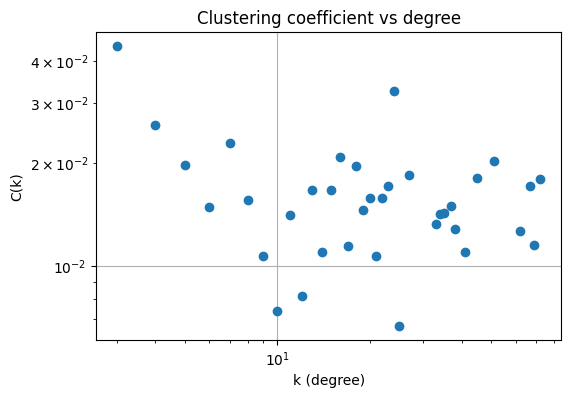

In [3]:
G = nx.barabasi_albert_graph(1000, 3)
plot_C_of_k(G)

## Task 2

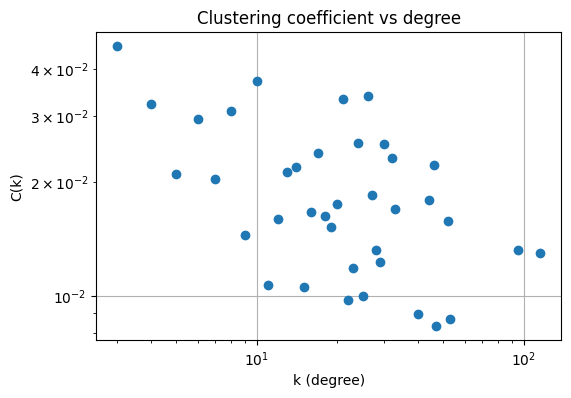

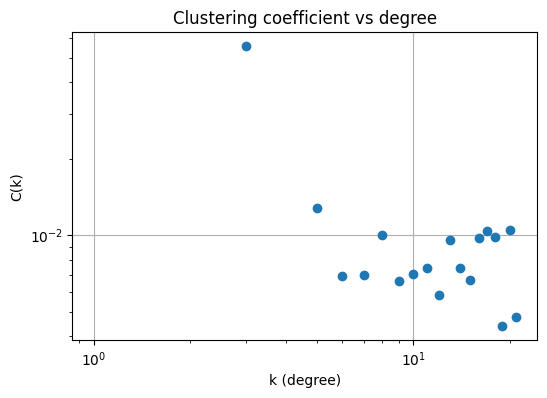

In [4]:
G_hier = nx.barabasi_albert_graph(1000, 3)
G_rand = nx.erdos_renyi_graph(1000, 0.01)

plot_C_of_k(G_hier)
plot_C_of_k(G_rand)


## Task 3

In [2]:
def load_gtfs_file(filename, use_cols=None, drop_cols=None):
    filepath = os.path.join("gtfs", filename)
    df = pd.read_csv(filepath, usecols=use_cols)
    if drop_cols:
        df = df.drop(columns=drop_cols, errors='ignore')
    return df

def clean_and_process_gtfs_data():
    df_cal = load_gtfs_file("calendar.txt", use_cols=["service_id", "start_date", "end_date"])
    df_trips = load_gtfs_file("trips.txt", drop_cols=["trip_headsign", "direction_id", "shape_id"])
    df_routes = load_gtfs_file("routes.txt", drop_cols=["agency_id", "route_long_name", "route_desc"])
    df_stop_times = load_gtfs_file("stop_times.txt", drop_cols=["stop_headsign", "pickup_type", "drop_off_type", "timepoint"])
    df_stops = load_gtfs_file("stops.txt", drop_cols=["stop_code"])

    df = (
        df_cal
        .merge(df_trips, on="service_id")
        .merge(df_routes, on="route_id")
        .merge(df_stop_times, on="trip_id")
        .merge(df_stops, on="stop_id")
    )

    # Remove times >= '24:00:00' to avoid ValueError
    df = df[df["arrival_time"] < '24:00:00']
    df = df[df["departure_time"] < '24:00:00']

    df["start_date"] = pd.to_datetime(df["start_date"], format="%Y%m%d")
    df["end_date"] = pd.to_datetime(df["end_date"], format="%Y%m%d")
    df["arrival_time"] = pd.to_datetime(df["arrival_time"], format="%H:%M:%S").dt.time
    df["departure_time"] = pd.to_datetime(df["departure_time"], format="%H:%M:%S").dt.time

    # Combine date and time to create full datetime objects
    df['arrival_datetime'] = pd.to_datetime(df['start_date'].dt.date.astype(str) + ' ' + df['arrival_time'].astype(str))
    df['departure_datetime'] = pd.to_datetime(df['start_date'].dt.date.astype(str) + ' ' + df['departure_time'].astype(str))

    df.drop(columns=[
        "arrival_time", "departure_time", "start_date", "end_date", "service_id",
        "stop_sequence", "shape_dist_traveled"
    ], inplace=True)

    # Calculate 'next_stop'
    df = df.sort_values(by=['trip_id', 'arrival_datetime'])
    df["next_stop"] = df.groupby("trip_id")["stop_id"].shift(-1).fillna(-1).astype('int')

    return df

df = clean_and_process_gtfs_data()
df.head(10)

,route_id,trip_id,route_short_name,route_type,stop_id,stop_name,stop_lat,stop_lon,arrival_datetime,departure_datetime,next_stop
391030,0_139,0_2_2261188,139,3,2878,Os. Kabaty,52.128946,21.068699,2025-12-22 05:12:00,2025-12-22 05:12:00,2880
391031,0_139,0_2_2261188,139,3,2880,Metro Kabaty,52.131174,21.067409,2025-12-22 05:13:00,2025-12-22 05:13:00,435
391032,0_139,0_2_2261188,139,3,435,Zaruby,52.132147,21.072043,2025-12-22 05:14:00,2025-12-22 05:14:00,6040
391033,0_139,0_2_2261188,139,3,6040,Wąwozowa,52.132730,21.075735,2025-12-22 05:15:00,2025-12-22 05:15:00,6039
391034,0_139,0_2_2261188,139,3,6039,Rosnowskiego,52.130334,21.078922,2025-12-22 05:16:00,2025-12-22 05:16:00,5922
391035,0_139,0_2_2261188,139,3,5922,Stare Kabaty,52.130482,21.084199,2025-12-22 05:17:00,2025-12-22 05:17:00,5920
391036,0_139,0_2_2261188,139,3,5920,Rów Natoliński,52.131025,21.089504,2025-12-22 05:17:00,2025-12-22 05:17:00,5918
391037,0_139,0_2_2261188,139,3,5918,Wiedeńska,52.130858,21.094473,2025-12-22 05:18:00,2025-12-22 05:18:00,4050
391038,0_139,0_2_2261188,139,3,4050,Korbońskiego,52.131335,21.098820,2025-12-22 05:19:00,2025-12-22 05:19:00,258
391039,0_139,0_2_2261188,139,3,258,Czekoladowa,52.132183,21.101014,2025-12-22 05:20:00,2025-12-22 05:20:00,259


In [6]:
df.route_type.unique()

array([3, 2, 0])

In [8]:
df[df['route_type']==2].head(10)

,route_id,trip_id,route_short_name,route_type,stop_id,stop_name,stop_lat,stop_lon,arrival_datetime,departure_datetime,next_stop
73463,0_S3,0_2_4733921,S3,2,8480,Warszawa Zachodnia,52.220141,20.964975,2025-12-22 04:28:00,2025-12-22 04:28:00,8484
73464,0_S3,0_2_4733921,S3,2,8484,Warszawa Centralna,52.228765,21.002869,2025-12-22 04:32:00,2025-12-22 04:33:00,8489
73465,0_S3,0_2_4733921,S3,2,8489,Warszawa Wschodnia,52.251503,21.052143,2025-12-22 04:39:00,2025-12-22 04:42:00,8530
73466,0_S3,0_2_4733921,S3,2,8530,Warszawa Targówek,52.264251,21.051748,2025-12-22 04:46:00,2025-12-22 04:46:00,8464
73467,0_S3,0_2_4733921,S3,2,8464,Warszawa Praga,52.277490,21.022383,2025-12-22 04:50:00,2025-12-22 04:50:00,8465
73468,0_S3,0_2_4733921,S3,2,8465,Warszawa Toruńska,52.293781,21.013265,2025-12-22 04:52:00,2025-12-22 04:52:00,8466
73469,0_S3,0_2_4733921,S3,2,8466,Warszawa Żerań,52.314239,20.998842,2025-12-22 04:55:00,2025-12-22 04:55:00,8467
73470,0_S3,0_2_4733921,S3,2,8467,Warszawa Płudy,52.334048,20.985907,2025-12-22 04:58:00,2025-12-22 04:58:00,8468
73471,0_S3,0_2_4733921,S3,2,8468,Warszawa Choszczówka,52.357706,20.972385,2025-12-22 05:01:00,2025-12-22 05:01:00,8469
73472,0_S3,0_2_4733921,S3,2,8469,Legionowo,52.401921,20.940980,2025-12-22 05:05:00,2025-12-22 05:05:00,-1


In [3]:
df_tram = df[df['route_type']==0]
df_train = df[df['route_type']==2]
df_bus = df[df['route_type']==3]

In [10]:
df_train['stop_id'].nunique()

62

In [11]:
df_bus['stop_id'].nunique()

6267

In [12]:
df_tram['stop_id'].nunique()

626

In [13]:
def build_static_graph(df):
    G = nx.DiGraph()  # directed is more correct for transport

    for _, row in df.iterrows():
        u = row["stop_id"]
        v = row["next_stop"]

        if pd.notna(v) and v != -1:
            G.add_edge(u, v)

    return G

In [14]:
train_graph = build_static_graph(df_train)

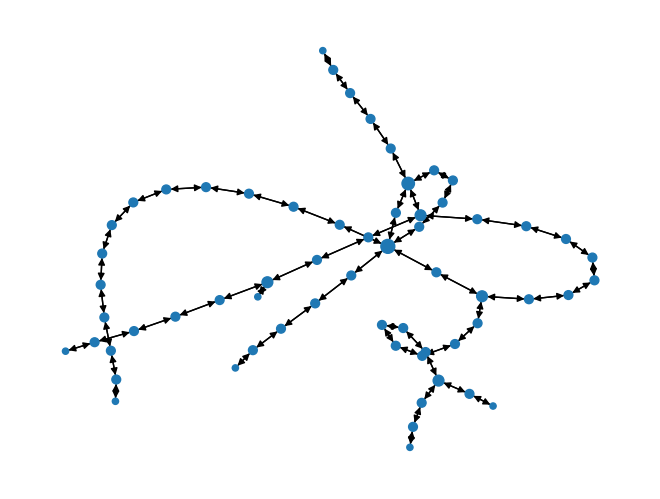

In [15]:
degrees = dict(train_graph.degree())
sizes = [degrees[n] * 10 for n in train_graph.nodes()]

nx.draw(train_graph, node_size=sizes)

In [16]:
tram_graph = build_static_graph(df_tram)

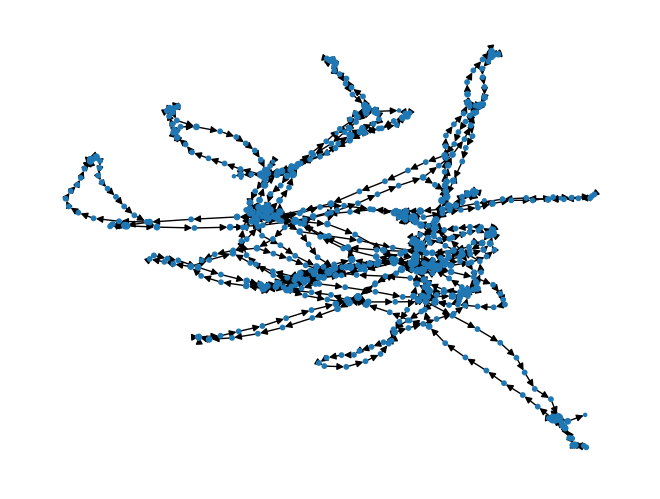

In [17]:
degrees = dict(tram_graph.degree())
sizes = [degrees[n] * 5 for n in tram_graph.nodes()]

nx.draw(tram_graph, node_size=sizes)

## Task 5

In [18]:
def draw_geographic_graph(
    G,
    df,
    labeled=False,
    figsize=(14, 14),
    node_size=5,
    node_color="red",
    edge_color="gray",
    edge_alpha=0.2,
    title="Geographic network layout",
    base_size = 8,
    scale = 1.2 
):

    # GPS → position dictionary
    pos = {
        row["stop_id"]: (row["stop_lon"], row["stop_lat"])
        for _, row in df.iterrows()
    }

    plt.figure(figsize=figsize)

    nx.draw_networkx_edges(
        G,
        pos,
        edge_color=edge_color,
        alpha=edge_alpha,
        width=0.5
    )

    degrees = dict(G.degree())
    
    sizes = [
        base_size + scale * degrees.get(n, 0)
        for n in G.nodes()
    ]

    nx.draw_networkx_nodes(
        G,
        pos,
        node_size=sizes,
        node_color=node_color
    )

    if labeled:
        labels = {
            row["stop_id"]: row["stop_name"]
            for _, row in df.iterrows()
        }
        nx.draw_networkx_labels(
            G,
            pos,
            labels=labels,
            font_size=8
        )
        
    plt.title(title)
    plt.axis("equal")
    plt.axis("off")
    plt.show()

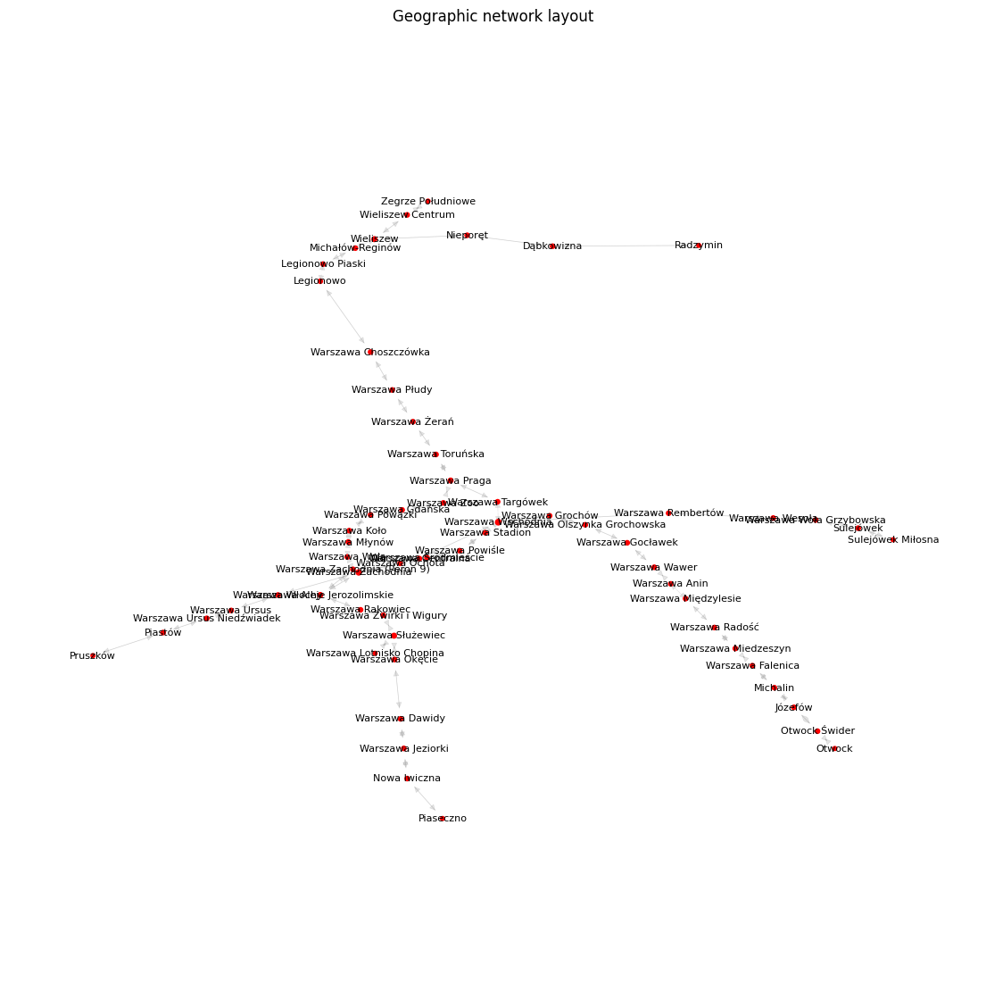

In [19]:
draw_geographic_graph(train_graph, df_train, labeled=True)

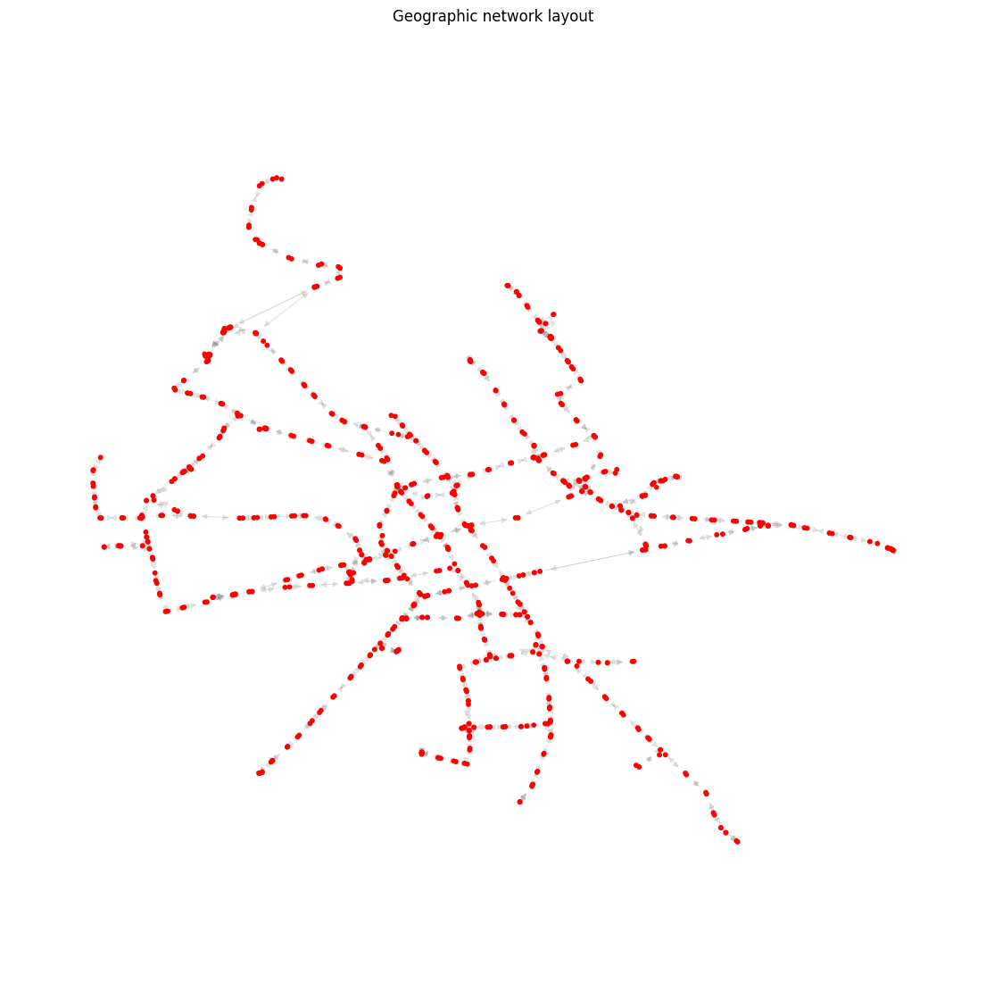

In [20]:
draw_geographic_graph(tram_graph, df_tram)

## Task 6, 7

In [59]:
day = "2025-12-22"

tram_day_df = df_tram[
    df_tram["departure_datetime"].dt.date
    == pd.to_datetime(day).date()
]

tram_day_df = tram_day_df.sort_values("departure_datetime")

In [60]:
first_trips = (
    tram_day_df
    .groupby("route_short_name")["trip_id"]
    .first()
)


In [61]:
tram_first_routes_df = tram_day_df[
    tram_day_df["trip_id"].isin(first_trips.values)
]

In [62]:
temporal_edges_tram = [
    (row["stop_id"], row["next_stop"], row["departure_datetime"])
    for _, row in tram_first_routes_df.iterrows()
    if pd.notna(row["next_stop"]) and row["next_stop"] != -1
]

In [64]:
pos_tram = {
    row["stop_id"]: (row["stop_lon"], row["stop_lat"])
    for _, row in tram_first_routes_df.iterrows()
}


In [65]:
time_step = pd.Timedelta(minutes=1)

t_min = tram_first_routes_df["departure_datetime"].min()
t_max = tram_first_routes_df["departure_datetime"].max()

frames = pd.date_range(t_min, t_max, freq=time_step)

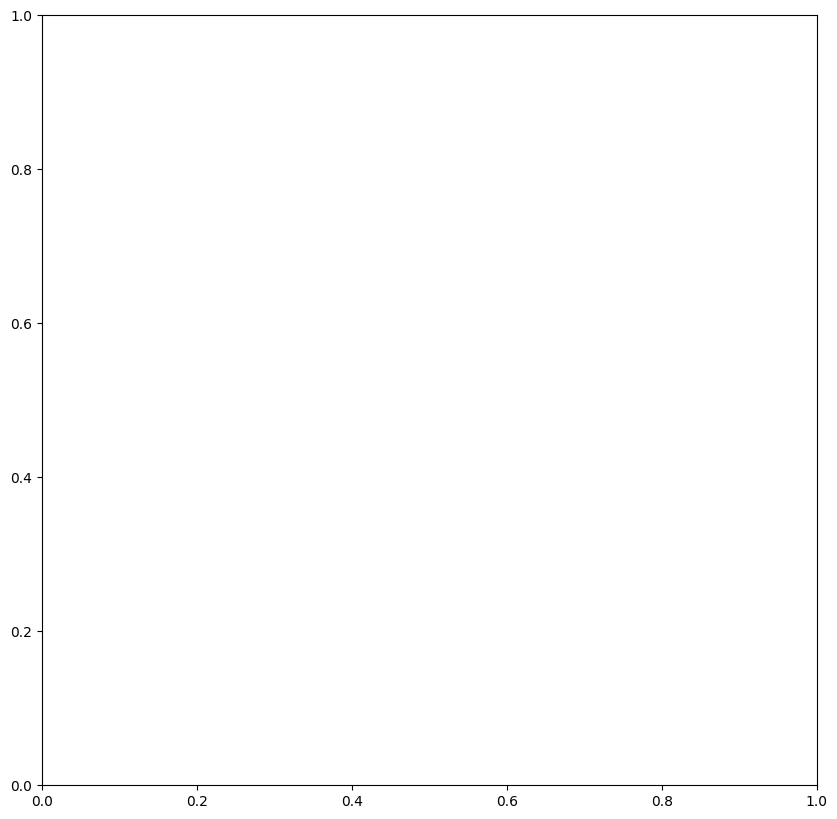

In [66]:
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(10, 10))

def update(frame_time):
    ax.clear()

    # active tram edges
    active_edges = [
        (u, v) for (u, v, t) in temporal_edges_tram
        if t < frame_time + time_step
    ]

    G_t = nx.Graph()
    G_t.add_edges_from(active_edges)

    nx.draw_networkx_edges(
        G_t,
        pos_tram,
        edge_color="blue",
        alpha=0.7,
        width=1,
        ax=ax
    )

    nx.draw_networkx_nodes(
        G_t,
        pos_tram,
        node_size=6,
        node_color="black",
        ax=ax
    )

    ax.set_title(f"Tram traffic – {frame_time.strftime('%H:%M')}")
    ax.axis("equal")
    ax.axis("off")


In [67]:
ani = FuncAnimation(
    fig,
    update,
    frames=frames,
    interval=300  # ms
)

plt.show()


In [68]:
from IPython.display import HTML
HTML(ani.to_jshtml())


In [70]:
day = "2025-12-22"

bus_day_df = df_bus[
    df_bus["departure_datetime"].dt.date
    == pd.to_datetime(day).date()
]

bus_day_df = bus_day_df.sort_values("departure_datetime")

first_trips = (
    bus_day_df
    .groupby("route_short_name")["trip_id"]
    .first()
)
bus_first_routes_df = bus_day_df[
    bus_day_df["trip_id"].isin(first_trips.values)
]

In [71]:
temporal_edges_bus = [
    (row["stop_id"], row["next_stop"], row["departure_datetime"])
    for _, row in bus_first_routes_df.iterrows()
    if pd.notna(row["next_stop"]) and row["next_stop"] != -1
]

In [72]:
pos_bus = {
    row["stop_id"]: (row["stop_lon"], row["stop_lat"])
    for _, row in bus_first_routes_df.iterrows()
}

In [78]:
time_step = pd.Timedelta(minutes=5)

t_min = bus_first_routes_df["departure_datetime"].min()
t_max = bus_first_routes_df["departure_datetime"].max()

frames = pd.date_range(t_min, t_max, freq=time_step)

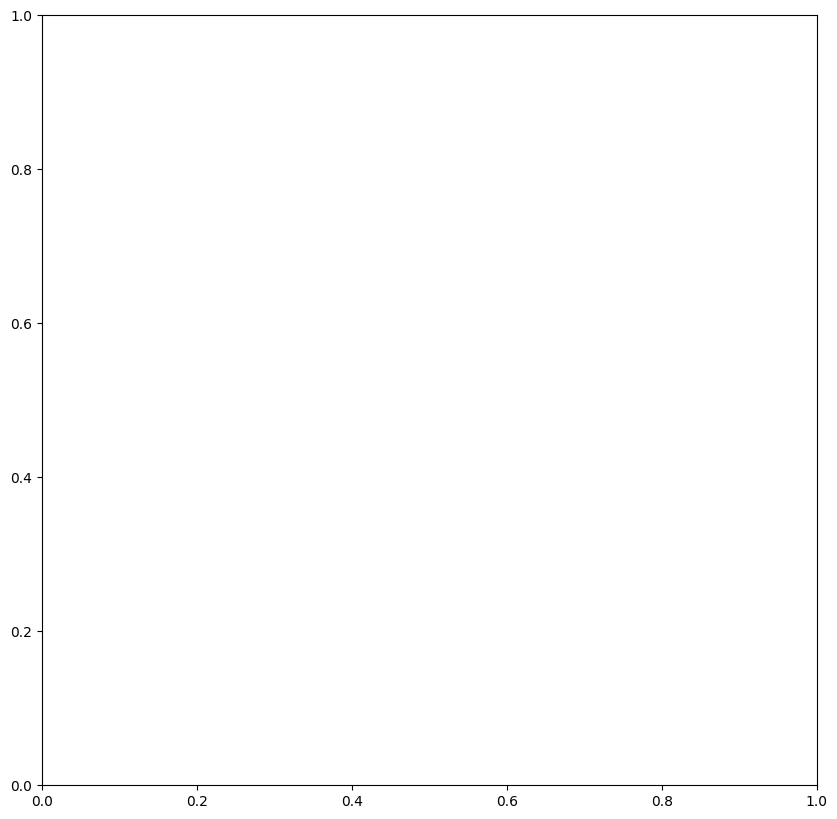

In [79]:
fig, ax = plt.subplots(figsize=(10, 10))

def update(frame_time):
    ax.clear()

    # active tram edges
    active_edges = [
        (u, v) for (u, v, t) in temporal_edges_bus
        if t < frame_time + time_step
    ]

    G_t = nx.Graph()
    G_t.add_edges_from(active_edges)

    nx.draw_networkx_edges(
        G_t,
        pos_bus,
        edge_color="blue",
        alpha=0.7,
        width=1,
        ax=ax
    )

    nx.draw_networkx_nodes(
        G_t,
        pos_bus,
        node_size=6,
        node_color="black",
        ax=ax
    )

    ax.set_title(f"Tram traffic – {frame_time.strftime('%H:%M')}")
    ax.axis("equal")
    ax.axis("off")

In [80]:
ani = FuncAnimation(
    fig,
    update,
    frames=frames,
    interval=300  # ms
)

plt.show()

In [81]:
bus_first_routes_df

,route_id,trip_id,route_short_name,route_type,stop_id,stop_name,stop_lat,stop_lon,arrival_datetime,departure_datetime,next_stop
874471,0_738,0_2_3211677,738,3,1536,Bieżuńska,52.273342,21.064440,2025-12-22 03:18:00,2025-12-22 03:18:00,1537
852695,0_720,0_2_4636844,720,3,1961,Edisona,52.229849,21.136793,2025-12-22 03:18:00,2025-12-22 03:18:00,1962
852696,0_720,0_2_4636844,720,3,1962,Trakt Lubelski,52.228167,21.140653,2025-12-22 03:19:00,2025-12-22 03:19:00,1996
874472,0_738,0_2_3211677,738,3,1537,Jórskiego,52.277512,21.067813,2025-12-22 03:19:00,2025-12-22 03:19:00,1874
874473,0_738,0_2_3211677,738,3,1874,Kościeliska,52.281107,21.070773,2025-12-22 03:20:00,2025-12-22 03:20:00,1875
...,...,...,...,...,...,...,...,...,...,...,...
68253,0_N88,0_2_4793757,N88,3,6578,Grójecka,52.199339,20.966028,2025-12-22 23:59:00,2025-12-22 23:59:00,-1
57413,0_N35,0_2_4793732,N35,3,3048,Keniga,52.193376,20.868173,2025-12-22 23:59:00,2025-12-22 23:59:00,-1
57412,0_N35,0_2_4793732,N35,3,2926,PKP Ursus-Niedźwiadek,52.192280,20.868770,2025-12-22 23:59:00,2025-12-22 23:59:00,3048
67311,0_N85,0_2_4793720,N85,3,2822,Berestecka,52.211903,20.951822,2025-12-22 23:59:00,2025-12-22 23:59:00,-1


In [82]:
from IPython.display import HTML
HTML(ani.to_jshtml())

Animation size has reached 20984243 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
